### Importing required libraries

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE
import xgboost as xgb
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, cohen_kappa_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
from pylab import rcParams
from imblearn.over_sampling import SMOTE

In [2]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

import pandas_profiling as pdpf

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (22.0 MB)


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Defining the dataset path

In [4]:
path = "/content/drive/MyDrive/Aleph Task/WineQT.csv"

In [5]:
df = pd.read_csv(path)
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Id
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,0
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5,1
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5,2
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6,3
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1138,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6,1592
1139,6.8,0.620,0.08,1.9,0.068,28.0,38.0,0.99651,3.42,0.82,9.5,6,1593
1140,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5,1594
1141,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6,1595


## 1. Exploratory Data Analysis

In [6]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Id
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,1
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,2
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,3
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,4


Since 'Id' column is similar to index, we can safely drop it as it is of no use for our analysis and prediction.

In [7]:
df = df.drop(columns="Id")

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1143 entries, 0 to 1142
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1143 non-null   float64
 1   volatile acidity      1143 non-null   float64
 2   citric acid           1143 non-null   float64
 3   residual sugar        1143 non-null   float64
 4   chlorides             1143 non-null   float64
 5   free sulfur dioxide   1143 non-null   float64
 6   total sulfur dioxide  1143 non-null   float64
 7   density               1143 non-null   float64
 8   pH                    1143 non-null   float64
 9   sulphates             1143 non-null   float64
 10  alcohol               1143 non-null   float64
 11  quality               1143 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 107.3 KB


### Checking for null values

In [9]:
df.isna().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [10]:
df.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

### Examining the dataset

In [11]:
df.describe().style.background_gradient()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000,1143.000000
mean,8.311111,0.531339,0.268364,2.532152,0.086933,15.615486,45.914698,0.996730,3.311015,0.657708,10.442111,5.657043
std,1.747595,0.179633,0.196686,1.355917,0.047267,10.250486,32.782130,0.001925,0.156664,0.170399,1.082196,0.805824
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.392500,0.090000,1.900000,0.070000,7.000000,21.000000,0.995570,3.205000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.250000,2.200000,0.079000,13.000000,37.000000,0.996680,3.310000,0.620000,10.200000,6.000000
75%,9.100000,0.640000,0.420000,2.600000,0.090000,21.000000,61.000000,0.997845,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,68.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [12]:
df.shape

(1143, 12)

In [13]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

From the above pandas profiling report which consists of a missing values graph, we can see that there are no missing values in the data. 

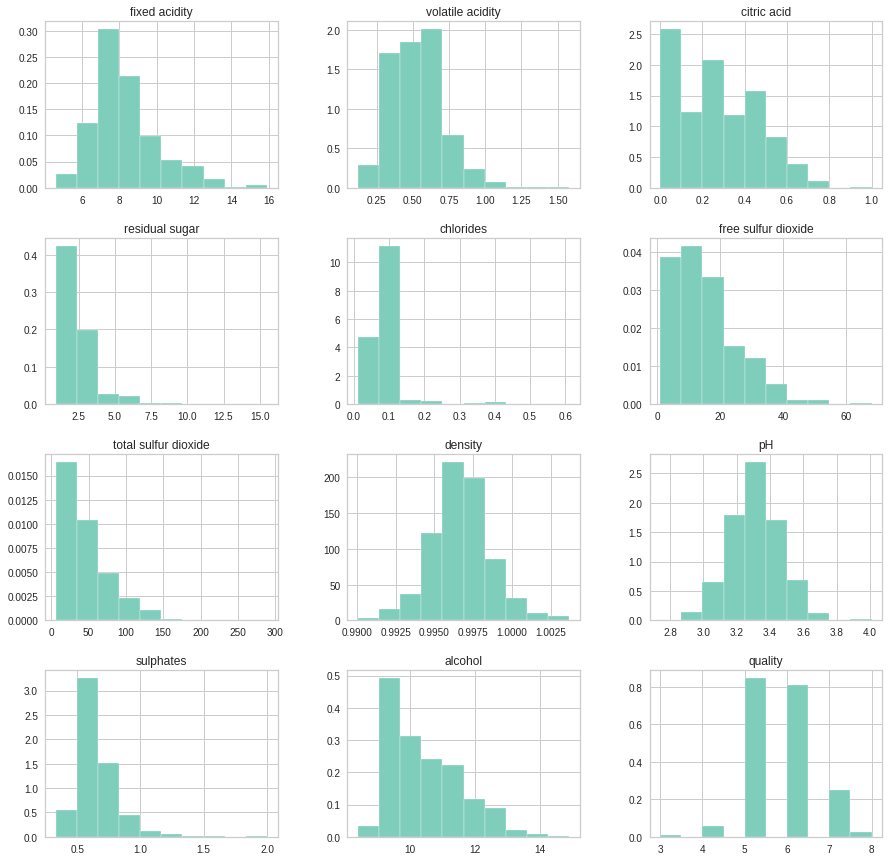

In [14]:
hist = df.hist(figsize=(15,15),color = '#7fcdbb', density = True, edgecolor='white', grid = True)

In [15]:
a = sns.pairplot(df,height = 12,kind ='scatter',hue = 'quality', diag_kind = 'kde')
plt.show()

From the above histogram and pair plots, we can see that the distribution of the variables is normal distribution. Hence we take Pearson's correlation. From the pair plot, we can also see that some pairs of variables are linearly correlated such as fixed acidity and density (positive correlation), pH and fixed acidity (negative correlation)

### Finding correlation and plotting the correlation heatmap

fixed acidity           0.12
volatile acidity       -0.41
citric acid             0.24
residual sugar          0.02
chlorides              -0.12
free sulfur dioxide    -0.06
total sulfur dioxide   -0.18
density                -0.18
pH                     -0.05
sulphates               0.26
alcohol                 0.48
quality                 1.00
Name: quality, dtype: float64


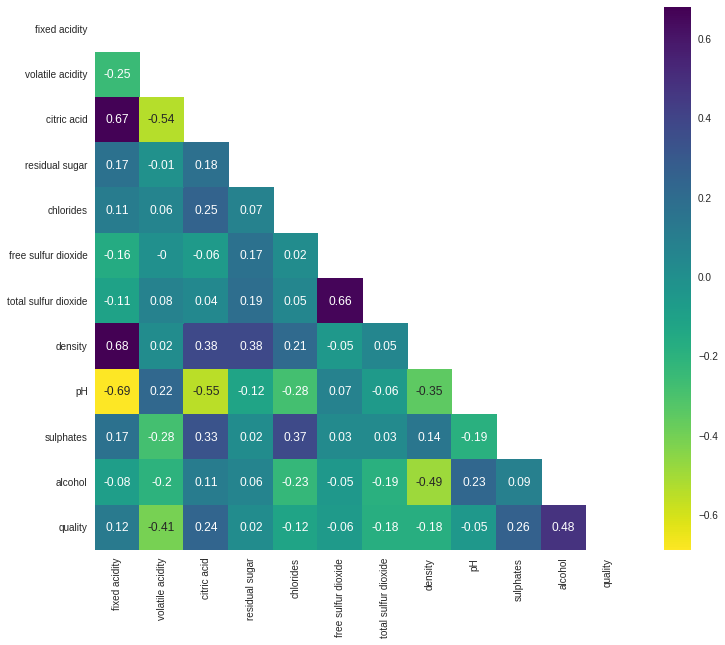

In [16]:
correlation = df.corr()
correlation = correlation.round(decimals = 2)

print(correlation['quality'])

mask = np.triu(np.ones_like(correlation, dtype=bool))
rcParams['figure.figsize'] = 12,10
sns.heatmap(correlation, 
           xticklabels = correlation.columns.values, 
           yticklabels = correlation.columns.values, 
           cmap="viridis_r",
           mask = mask,
           annot = True)

### Finding correlation of features with target variable and sorting in order of increasing correlation

In [17]:
print(correlation['quality'].reindex(correlation['quality'].abs().sort_values().index))

residual sugar          0.02
pH                     -0.05
free sulfur dioxide    -0.06
fixed acidity           0.12
chlorides              -0.12
total sulfur dioxide   -0.18
density                -0.18
citric acid             0.24
sulphates               0.26
volatile acidity       -0.41
alcohol                 0.48
quality                 1.00
Name: quality, dtype: float64


From the correlation values, it can be noted that the top 5 factors influencing wine quality in decreasing order are alcohol, volatile acidity, sulphates, citric acid, and density. While alcohol, sulphates and citric acid are positively correlated with quality, volatile acidity and density are negatively correlated.

### Plotting boxplot to check for outliers in feature variables

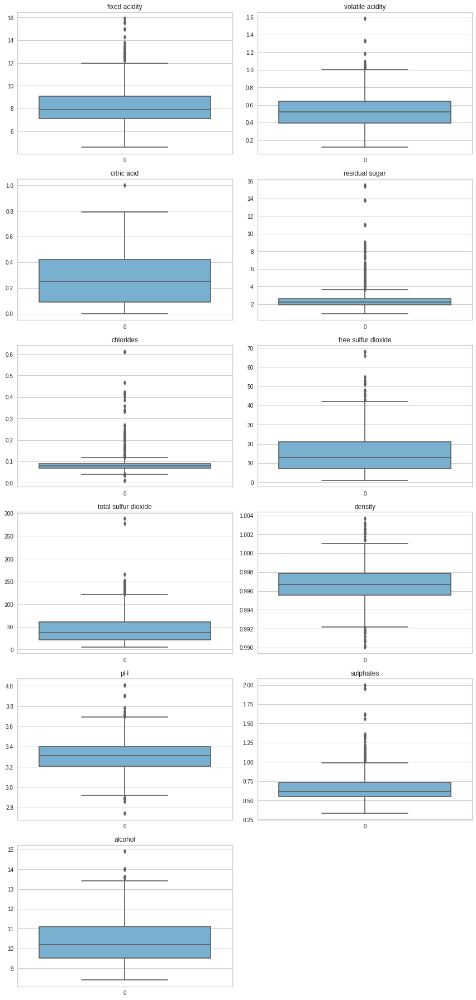

In [19]:
fig, axes = plt.subplots(6, 2, figsize = (12,25))

ind = 0
cols = df.columns
for i in range (0,6) :
  for j in range (0,2): 
    if cols[ind] == 'quality':
      break
    sns.boxplot(data = df[cols[ind]],  orient='v', ax = axes[i,j], color='#6ab4de')
    axes[i][j].set_title(cols[ind])
    ind = ind+1

fig.delaxes(axes[5][1])
fig.tight_layout()

As can be seen from the above boxplots, we observe that except for the columns 'citric acid' and 'alcohol' which relatively have lesser outliers, all the other 9 columns namely 'fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides' ,'free sulphur dioxide', 'total sufure dioxide', 'density', 'pH', 'sulphates and 'alcohol' have quite a lot of outliers. 

### Visualizing wine attributes

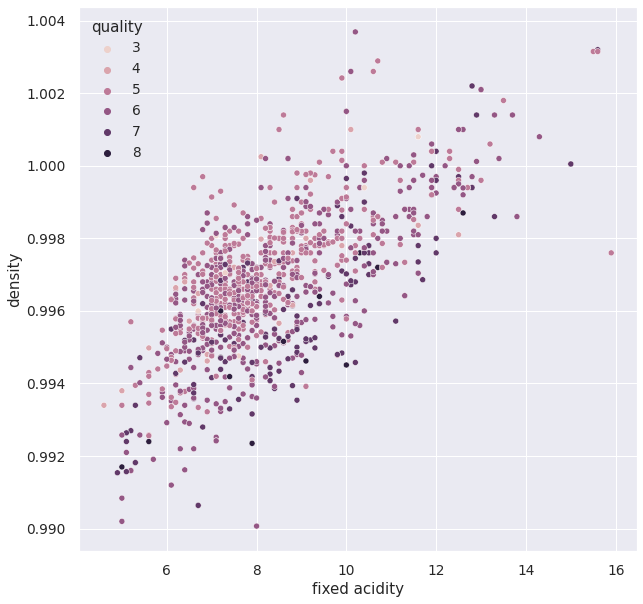

In [21]:
rcParams['figure.figsize'] = 10,10
sns.set(font_scale=1.25)
a = sns.scatterplot(data = df, x = "fixed acidity", y = "density", hue = 'quality')

The above scatter plot shows the relation between density and fixed acidity of the wines for the different qualities. It can be seen that there is a positive correlation between density and fixed acidity.

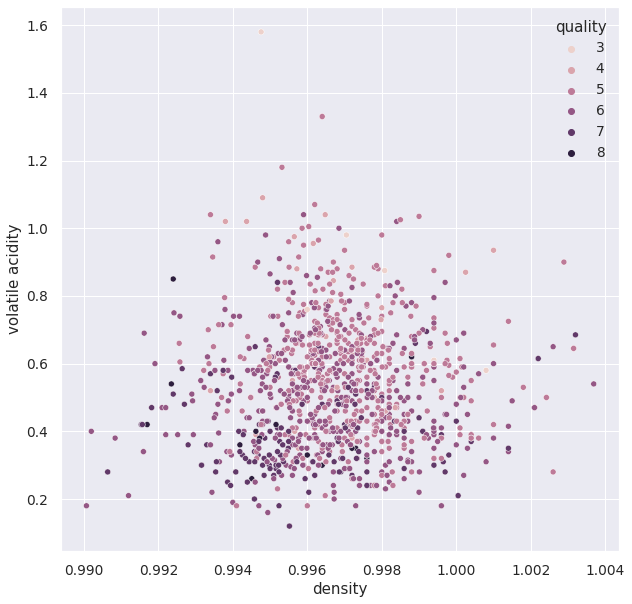

In [22]:
a = sns.scatterplot(data = df, x = "density", y = "volatile acidity", hue = 'quality')

The above plot shows the relation among density and volatile acidity, no meaningful pattern can be observed.

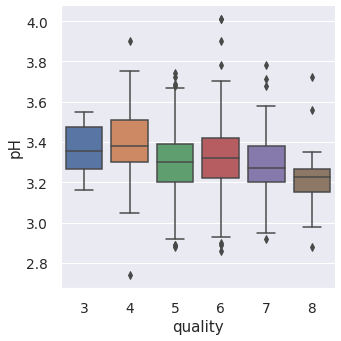

In [23]:
a = sns.catplot(data = df, kind='box', x='quality', y='pH')

The above box plot shows the distribution of pH values across the different wine quality values. Except for quality = 3, the pH values for rest of the qualities have some outliers. It can be seen that quality = 4 has higher pH value range between 3.3 and 3.5 approx. Quality = 8 has the least pH values in the range of 3.1 to 3.3 (approx).  

### Checking for imbalanced dataset

Current sample size: 1143


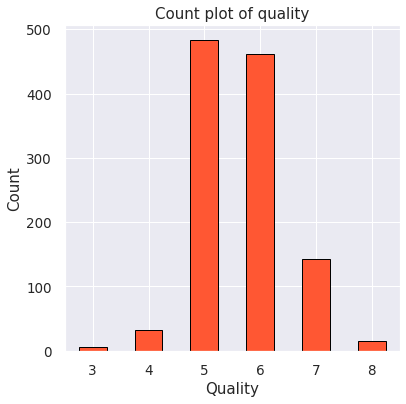

In [24]:
classes = df_target.groupby(df_target.values).count()
a = classes.plot.bar(figsize = (6,6), color = '#FF5733', rot = 0, xlabel = 'Quality', ylabel = 'Count', fontsize = 13.5, title = 'Count plot of quality', edgecolor = 'black')
print("Current sample size:", df_target.shape[0])

This plot shows that the data is imbalanced, the two classes with qualities 5 and 6 have the most number samples. This proves that needs to be balanced by applying SMOTE (Synthetic Minority Oversampling Technique) on the dataset. 

### SMOTE Upsampling

In [25]:
smote = SMOTE(random_state = 150)
X_smote,y_smote = smote.fit_resample(df_features,df_target)

New sample size after upsampling: 2898


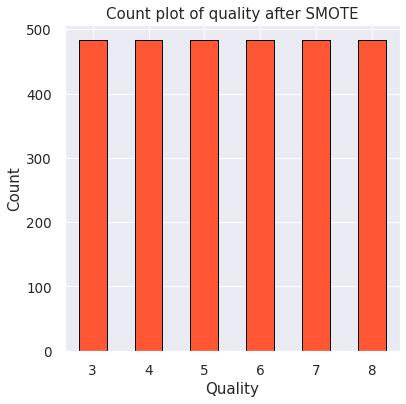

In [26]:
classes = y_smote.groupby(y_smote.values).count()
a = classes.plot.bar(figsize = (6,6), color = '#FF5733', rot = 0, xlabel = 'Quality', ylabel = 'Count', fontsize = 13.5, title = 'Count plot of quality after SMOTE',edgecolor = 'black')
print("New sample size after upsampling:", y_smote.shape[0])

We see that the sample size has increased from 1143 to 2898 after applying SMOTE. Also, the count plot shows that all the classes are distributed evenly across the target variable 'quality'

## Clustering to find out the different types of wine

Before clustering, we try to find out the ideal value of 'k' (k = number of clusters) by using the Elbow method. 

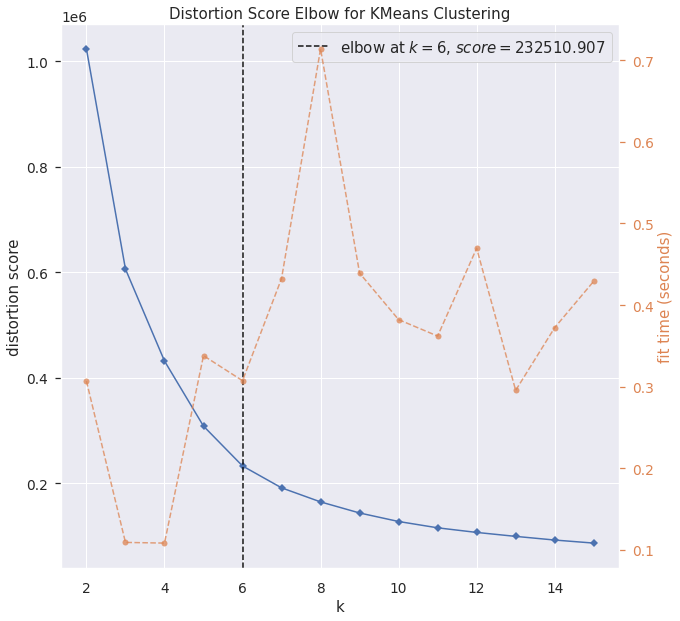

In [27]:
vis = KElbowVisualizer(KMeans(), k=15)
a = vis.fit(X_smote)
c = vis.show()

With this elbow value of k=6, we do clustering. n_clusters is the k value here.

The upsampled features and target has been combined into one variable and PCA (Principal Component Analysis) has been done on it for easier visualization.

In [46]:
from sklearn.decomposition import PCA

smote = pd.concat([X_smote, y_smote], axis=1)
pca = PCA()
X = pca.fit_transform(smote)
#print(X[0])
#X[0,11]

In [47]:
kmeans = KMeans(n_clusters = 6)
label = kmeans.fit_predict(X)
unique_labels = np.unique(label)
print (unique_labels)

[0 1 2 3 4 5]


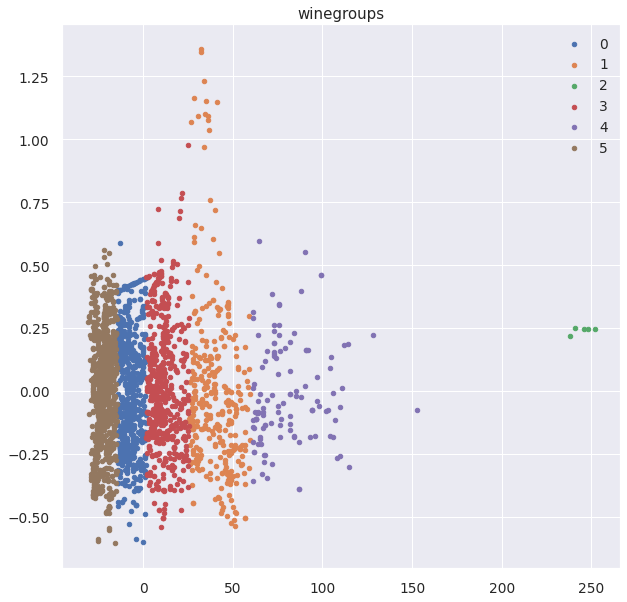

In [49]:
for i in unique_labels:
    plt.scatter(X[label==i,0],X[label==i,3],label=i,s=20)

plt.legend()
plt.title("winegroups")
plt.show()

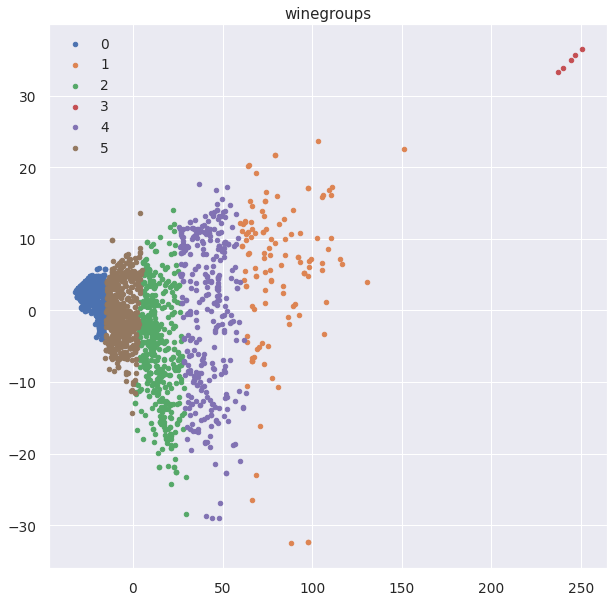

In [31]:
for i in unique_labels:
    plt.scatter(X[label==i,0],X[label==i,1],label=i,s=20)
plt.legend()
plt.title("winegroups")
plt.show()

The wines have been clustered into 6 groups based on the value of k = 6 using different columns as shown in the above scatter plots. 

## Predicting wine quality

### Splitting the data into test and training for prediction

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X_smote, y_smote, test_size=0.20, random_state=1)

### Feature selection using RFE (Recursive Feature Elimination) method

In [33]:
model = RandomForestClassifier()
rfe = RFE(model, n_features_to_select=7)
fit = rfe.fit(X_train, y_train)

print("Number of Features to be selected: %s" % (fit.n_features_))
print("Selected Features: %s" % (fit.support_))
print("Feature Ranking: %s" % (fit.ranking_))
selected_features = X_smote.columns[(fit.get_support())]
print(selected_features)

Number of Features to be selected: 7
Selected Features: [False  True False False  True  True  True False  True  True  True]
Feature Ranking: [5 1 3 4 1 1 1 2 1 1 1]
Index(['volatile acidity', 'chlorides', 'free sulfur dioxide',
       'total sulfur dioxide', 'pH', 'sulphates', 'alcohol'],
      dtype='object')


Dropping the 4 features which were not suggested by RFE -

In [34]:
X_smote.drop('density', axis = 1, inplace = True)
X_smote.drop('fixed acidity', axis = 1, inplace = True)
X_smote.drop('residual sugar', axis = 1, inplace = True)
X_smote.drop('free sulfur dioxide', axis = 1, inplace = True)

X_smote.shape

(2898, 7)

Splitting the dataset again after dropping the features -

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X_smote, y_smote, test_size=0.20, random_state=1)

We will go with tree based ML algorithms for prediction, as they are best suited for classification type problems. Our options are Decision tree and Random Forest. Comparing decision tree and random forest, random forest has an edge as it follows ensemble technique and a collective decision taken by multiple decision trees is always better than a single decision tree's result.

### Random Forest Algorithm

#### Prediction

In [58]:
model = RandomForestClassifier(n_estimators = 100)
model = model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)
print("Training Accuracy for Random Forest Algorithm:",(accuracy_score(y_pred_train, y_train)*100))
print("Test Accuracy for Random Forest Algorithm:",(accuracy_score(y_pred_test, y_test)*100))

Training Accuracy for Random Forest Algorithm: 100.0
Test Accuracy for Random Forest Algorithm: 84.48275862068965


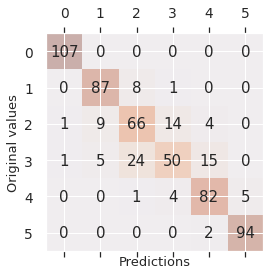

              precision    recall  f1-score   support

           3      0.982     1.000     0.991       107
           4      0.861     0.906     0.883        96
           5      0.667     0.702     0.684        94
           6      0.725     0.526     0.610        95
           7      0.796     0.891     0.841        92
           8      0.949     0.979     0.964        96

    accuracy                          0.838       580
   macro avg      0.830     0.834     0.829       580
weighted avg      0.834     0.838     0.833       580



In [37]:
conf_matrix = confusion_matrix(y_true = y_test, y_pred = y_pred_test)
fig, axes = plt.subplots(figsize=(4, 4))
axes.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        axes.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='medium')
 
plt.xlabel('Predictions', fontsize=13)
plt.ylabel('Original values', fontsize=13)
plt.show()

# Print the precision and recall, among other metrics
print(classification_report(y_test, y_pred_test, digits=3))

Random forest is advantageous because it builds an ensemble of decision trees and combines the results together by using the concept of bagging. This reduces chances of overfitting and also increases the performance of the model by giving higher accuracy. Random forest algorithm can be employed for both classification and regression problems and handles data outliers effectively. The strong performance is evident by it's accuracy of 84.48%.

The very fact that it builds a large number of trees is also a disadvantage as it increases the complexity of the model. This in turn requires huge computing power and takes longer running times.